In [102]:
import pandas as pd
import numpy as np
import warnings
import os
import re
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.linear_model import LinearRegression
import keras

warnings.filterwarnings('ignore')

In [40]:
# employment_by_occupation = pd.read_csv("datasets/employment_by_occupation.csv")
# # immigrant_statistics = pd.read_csv("datasets/immigrant_statistics.csv")
# # job_listings = pd.read_csv("datasets/job_listings.csv")
# labor_market_statistics = pd.read_csv("datasets/labor_market_statistics.csv")
# lse_historical_data = pd.read_csv("datasets/lse_historical_data.csv")
# # uk_bill_data = pd.read_csv("datasets/uk_bill_data.csv")
# EUReferendumData = pd.read_csv("datasets/EUReferendumData.csv")
# annualPayByConstituency_2019 = pd.read_excel("datasets/annualPayByConstituency_2019.xls")
# annualPayByConstituency_2016 = pd.read_excel("datasets/annualPayByConstituency_2016.xls")

In [103]:
years=["2012", "2013", "2014", "2015", "2016", "2017", "2018", "2019"]
# skiprows = [0, 1, 2, 3, 4, 34, 110, 165, 212, 272, 331, 405, 490, 246, 587, 647]

dfs={}
for year in years:
    # f=open(r"C:\Users\neeln\Downloads\Datasets-20191109T084613Z-001\Citadel Dump\lmregtabcc02%s.xls" % name, "rb")
    dfs[year]=pd.read_excel("datasets/annualPay_%s.xls" % year, sheet_name = "All", header=4, usecols=[0,1,2,3,4,5,6], skiprows = [0, 1, 2, 3, 4], names=["Constituency", "Code", "Jobs in thousands", "Median", "Median percentage change", "Mean", "Mean percentage change"])
    dfs[year] = dfs[year].dropna(subset=["Code", "Jobs in thousands"])
    dfs[year] = dfs[year].replace('x', np.nan)
    dfs[year] = dfs[year][dfs[year].Constituency != "North West"]
    dfs[year] = dfs[year][dfs[year].Constituency != "Yorkshire and The Humber"]
    dfs[year] = dfs[year][dfs[year].Constituency != "East Midlands"]
    dfs[year] = dfs[year][dfs[year].Constituency != "West Midlands"]
    dfs[year] = dfs[year][dfs[year].Constituency != "East"]
    dfs[year] = dfs[year][dfs[year].Constituency != "London"]
    dfs[year] = dfs[year][dfs[year].Constituency != "South East"]
    dfs[year] = dfs[year][dfs[year].Constituency != "South West"]
    dfs[year] = dfs[year][dfs[year].Constituency != "Wales"]
    dfs[year] = dfs[year][dfs[year].Constituency != "Scotland"]
    dfs[year] = dfs[year][dfs[year].Constituency != "Northern Ireland"]



In [104]:
EUReferendumData = pd.read_csv("datasets/EUReferendumData.csv")
EUReferendumData = EUReferendumData[["PCON11CD", "Constituency", "Figure to use"]]

In [81]:
def missing_percentage(df):
    """This function takes a DataFrame(df) as input and returns two columns, total missing values and total missing values percentage"""
    total = df.isnull().sum().sort_values(ascending = False)[df.isnull().sum().sort_values(ascending = False) != 0]
    percent = round(df.isnull().sum().sort_values(ascending = False)/len(df)*100,2)[round(df.isnull().sum().sort_values(ascending = False)/len(df)*100,2) != 0]
    return pd.concat([total, percent], axis=1, keys=['Total','Percent'])
    

In [106]:
import geopandas as gpd
import matplotlib.pyplot as plt
map_df = gpd.read_file("datasets/constituencies_shapefile/Westminster_Parliamentary_Constituencies_December_2017_Generalised_Clipped_Boundaries_in_the_UK.shp")


In [107]:
combined = map_df.set_index("pcon17cd").join(EUReferendumData.set_index("PCON11CD")).reset_index()
# combined = map_df.set_index("pcon17cd").join(dfs["2019"].set_index("Code")).reset_index()

In [108]:
combined = combined.rename(columns={"Figure to use": "percentage"})
combined.percentage = combined.percentage*100
combined = combined.dropna()

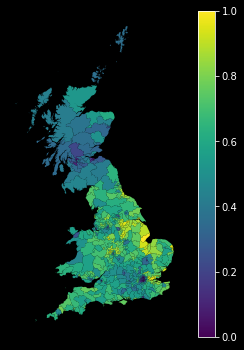

In [109]:
fig, ax = plt.subplots(1, figsize=(6, 6))
combined.plot(column="percentage", cmap="viridis", linewidth=0.8, ax=ax)
ax.axis("off")

sm = plt.cm.ScalarMappable(cmap="viridis")
sm._A = []
cbar = fig.colorbar(sm)

In [91]:
combined_2019 = map_df.set_index("pcon17cd").join(dfs["2019"].set_index("Code")).reset_index()
combined_2019 = combined_2019.dropna()
# combined_2019["Median percentage change"] = combined_2019["Jobs in thousands"]*combined_2019.Mean

fig, ax = plt.subplots(1, figsize=(6, 6))
combined_2019.plot(column="Median percentage change", cmap="viridis", linewidth=0.8, ax=ax)
ax.axis("off")

sm = plt.cm.ScalarMappable(cmap="viridis")
sm._A = []
cbar = fig.colorbar(sm)

In [89]:
combined_2013 = map_df.set_index("pcon17cd").join(dfs["2013"].set_index("Code")).reset_index()
combined_2013 = combined_2013.dropna()

fig, ax = plt.subplots(1, figsize=(6, 6))
combined_2013.plot(column="Mean percentage change", cmap="viridis", linewidth=0.8, ax=ax)
ax.axis("off")

sm = plt.cm.ScalarMappable(cmap="viridis")
sm._A = []
cbar = fig.colorbar(sm)

In [110]:
dfs["2019"].Mean

0      24866.0
1      24762.0
2      27751.0
3      25046.0
4      32233.0
        ...   
637    25279.0
638    29431.0
639    36184.0
640    36064.0
641    25434.0
Name: Mean, Length: 633, dtype: float64

In [111]:
dfs["2013"].Mean

0      24790.0
1      21507.0
2      24991.0
3      22814.0
4      25353.0
        ...   
637    21433.0
638    23989.0
639    32853.0
640    31663.0
641    24222.0
Name: Mean, Length: 632, dtype: float64

In [112]:
difference = dfs["2019"]
difference["Mean percentage change"] = (difference.Mean - dfs["2013"].Mean)/dfs["2013"].Mean
difference

,Constituency,Code,Jobs in thousands,Median,Median percentage change,Mean,Mean percentage change
0,Berwick-upon-Tweed,E14000554,21.0,19095.0,-1.2,24866.0,0.003066
1,Bishop Auckland,E14000569,28.0,23281.0,NaN,24762.0,0.151346
2,Blaydon,E14000574,31.0,23829.0,1.0,27751.0,0.110440
3,Blyth Valley,E14000575,31.0,22480.0,9.8,25046.0,0.097835
4,City of Durham,E14000641,27.0,25463.0,3.7,32233.0,0.271368
...,...,...,...,...,...,...,...
637,"Ross, Skye and Lochaber",S14000055,23.0,23411.0,4.8,25279.0,0.179443
638,Rutherglen and Hamilton West,S14000056,41.0,24932.0,6.4,29431.0,0.226854
639,Stirling,S14000057,NaN,NaN,NaN,36184.0,0.101391
640,West Aberdeenshire and Kincardine,S14000058,36.0,29076.0,7.9,36064.0,0.138995


(-26993.591365000422,
 688151.3878649997,
 -20725.20670500053,
 1083974.1034050009)

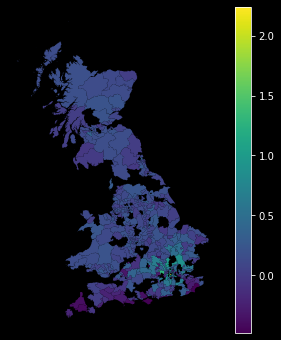

In [115]:
combined_difference = map_df.set_index("pcon17cd").join(difference.set_index("Code")).reset_index()
combined_difference = combined_difference.dropna()

fig, ax = plt.subplots(1, figsize=(6, 6))
combined_difference.plot(column="Mean percentage change", cmap="viridis", linewidth=0.8, ax=ax, legend = True)
ax.axis("off")
# world.plot(column='pop_est', ax=ax, legend=True)

# sm = plt.cm.ScalarMappable(cmap="viridis")
# sm._A = []
# cbar = fig.colorbar(sm)

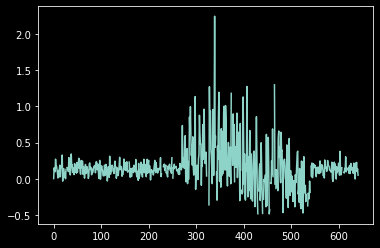

In [124]:
plt.plot(difference["Mean percentage change"])


In [134]:
difference_significant = difference[(difference["Mean percentage change"] > 0.5) | (difference["Mean percentage change"] < - 0.05)]
difference_significant

,Constituency,Code,Jobs in thousands,Median,Median percentage change,Mean,Mean percentage change
271,Brentwood and Ongar,E14000594,30.0,30212.0,NaN,40740.0,0.735094
276,Castle Point,E14000622,26.0,NaN,NaN,32449.0,0.552658
277,Central Suffolk and North Ipswich,E14000624,40.0,26235.0,NaN,32514.0,0.595231
282,Great Yarmouth,E14000717,28.0,19985.0,NaN,23743.0,-0.066596
286,Hertford and Stortford,E14000744,46.0,32134.0,8.0,41799.0,0.850906
...,...,...,...,...,...,...,...
535,Totnes,E14001001,19.0,18194.0,NaN,23331.0,-0.372181
536,Truro and Falmouth,E14001003,34.0,23378.0,6.6,26436.0,-0.198836
537,Wells,E14001026,36.0,NaN,NaN,27707.0,-0.215699
538,West Dorset,E14001031,31.0,22944.0,8.4,25791.0,-0.276022


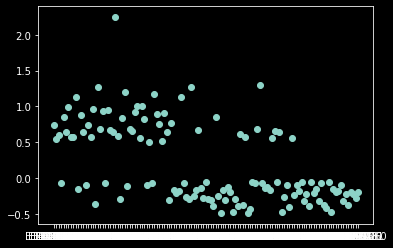

In [135]:
plt.scatter(difference_significant["Code"], difference_significant["Mean percentage change"])


In [136]:
combined_difference = difference_significant.set_index("Constituency").join(EUReferendumData.set_index("Constituency")).reset_index()